In [1]:
import brian2

In [2]:
import pickle

f=open("/media/maria/DATA/BrainObservatoryProcessedData/openai_clip-vit-base-patch32_embeddings.pkl",'rb')
currents=pickle.load(f)

In [3]:
emb_clip=currents['natural_movie_one']

In [4]:
print(emb_clip.shape)

(900, 768)


In [5]:
import plotly.graph_objects as go

import pandas as pd

# Read data from a csv
z_data = emb_clip[:,:]

fig = go.Figure(data=[go.Surface(z=z_data, colorscale='sunset')])

fig.update_layout(title='Mt Bruno Elevation', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()

In [6]:
from brian2 import TimedArray, PoissonGroup, Hz, ms, SpikeMonitor, run
#stimulus = TimedArray(np.tile([100., 0.], 5)*Hz, dt=100.*ms)
stimulus=TimedArray(emb_clip[:,0]*Hz, dt=1.*ms)
P = PoissonGroup(1, rates='stimulus(t)')

M = SpikeMonitor(P)

run(1000*ms) 

In [11]:
M.num_spikes

0

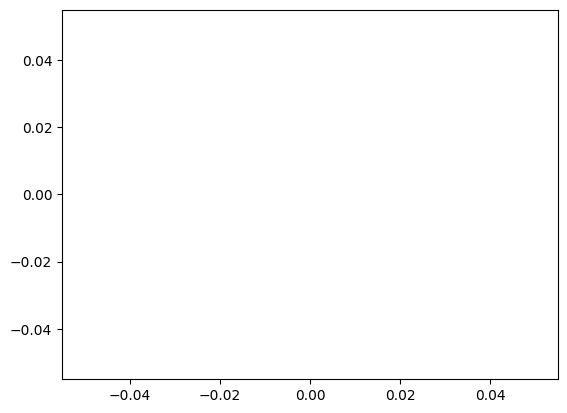

In [9]:
from brian2 import plot
plot(M.t/ms, M.i, '.')

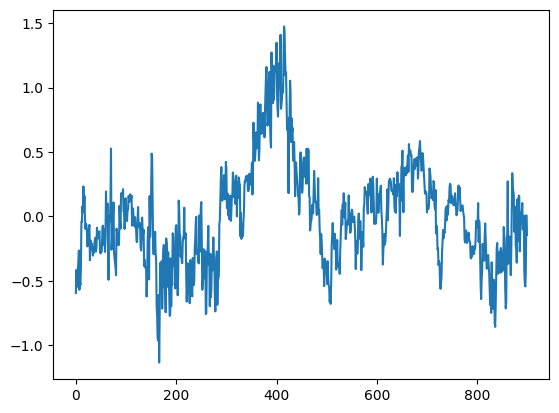

In [ ]:
import matplotlib.pyplot as plt

plt.plot(emb_clip[:,0])